In [16]:
#Imports

import pandas as pd
from sklearn.model_selection import train_test_split
from xgboost import XGBClassifier
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, mean_squared_error
import numpy as np
from sklearn.metrics import f1_score

import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, confusion_matrix
from imblearn.under_sampling import RandomUnderSampler
from imblearn.over_sampling import SMOTE
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler
from imblearn.pipeline import Pipeline as ImbPipeline
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, mean_squared_error
import numpy as np

from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import OneHotEncoder, FunctionTransformer
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.ensemble import RandomForestRegressor
from sklearn.cluster import KMeans
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import f1_score
from xgboost import XGBClassifier

from sklearn.linear_model import Ridge, Lasso
from sklearn.ensemble import RandomForestRegressor
from xgboost import XGBRegressor
from sklearn.svm import SVR

from sklearn.model_selection import GridSearchCV
from sklearn.metrics import mean_squared_error
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import balanced_accuracy_score
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score, median_absolute_error

import pickle
import matplotlib.pyplot as plt
import seaborn as sns
import folium

# Configuración warnings
# ==============================================================================
import warnings
warnings.filterwarnings('ignore')

In [2]:
# Warnings deactivation
warnings.simplefilter('ignore')

In [10]:
# Data Load
df = pd.read_csv('Housing_Price_Prediction_ML/data/house_data.csv', parse_dates=['date'], sep=',')


**Features Enginering**

In [11]:
# Convert square feet to square meters
columns_to_convert = ['sqft_living', 'sqft_lot', 'sqft_above', 'sqft_basement', 'sqft_living15', 'sqft_lot15']
for column in columns_to_convert:
    df[column] = df[column] * 0.092903
df.rename(columns=lambda x: x.replace('sqft', 'm2') if 'sqft' in x else x, inplace=True)

**Create an additional variable (basement)**

Although basement square meters have a moderate correlation (0.32), the presence or absence of a basement can be a key differentiator.

We add a binary variable (basement) to complement the information:

In [12]:
df['basement'] = (df['m2_basement'] > 0).astype(int)
#df.head()

This allows the model to capture both the impact of the presence of a basement and its size.


**Create an additional variable (renovated)**

Although the renovation year has a low correlation (0.12), the fact of being renovated or not can be a key differentiator.

We add a binary variable (renovated) to complement the information:

In [13]:
df['renovated'] = (df['yr_renovated'] > 0).astype(int)
#df.head()


This allows the model to capture both the impact of having been renovated and the date of the renovation.

**We apply a clustering algorithm to group the houses into zones.**

In [14]:
# Scale Coordenates
scaler = StandardScaler()
coords_scaled = scaler.fit_transform(df[['lat', 'long', 'price']])

# K-Means clustering
kmeans = KMeans(n_clusters=10, random_state=42, n_init=10)  # Cambia n_clusters según el caso
df['area'] = kmeans.fit_predict(coords_scaled)


The new variable zone can be used as a categorical variable in the model.

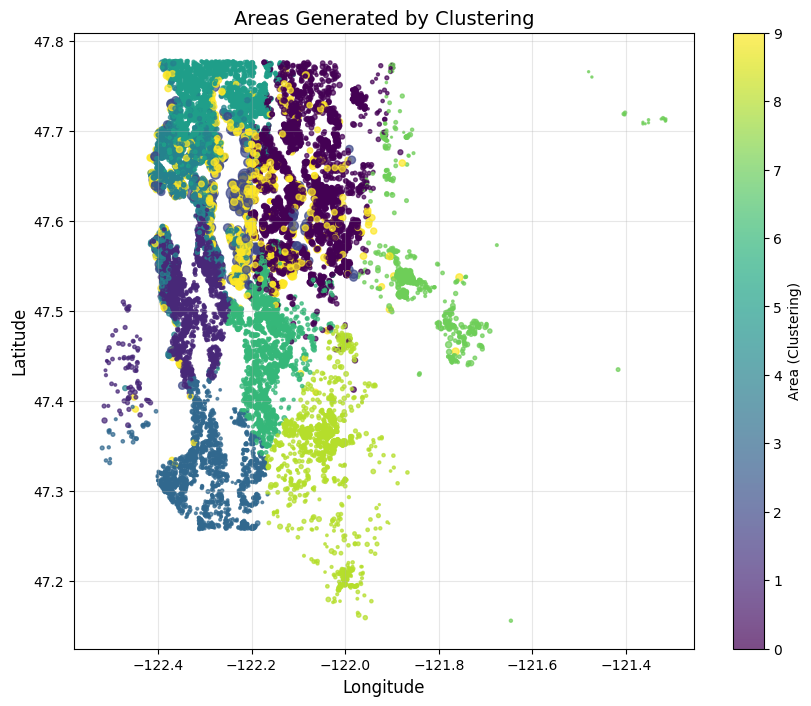

In [15]:
# Graficar las áreas generadas por el clustering
plt.figure(figsize=(10, 8))
scatter = plt.scatter(
    df['long'],  # Coordenada en el eje x (longitud)
    df['lat'],   # Coordenada en el eje y (latitud)
    c=df['area'],  # Color según el área generada por K-Means
    cmap='viridis',  # Mapa de colores
    s=df['price'] / df['price'].max() * 100,  # Escalar el tamaño por precio
    alpha=0.7      # Transparencia de los puntos
)

# Añadir barra de colores para los clusters
plt.colorbar(scatter, label='Area (Clustering)')

# Personalización de la gráfica
plt.title('Areas Generated by Clustering', fontsize=14)
plt.xlabel('Longitude', fontsize=12)
plt.ylabel('Latitude', fontsize=12)
plt.grid(alpha=0.3)

# Guardar la gráfica como un archivo PNG
plt.savefig('Areas.png', dpi=300, bbox_inches='tight')

# Mostrar la gráfica
plt.show()

In [17]:

# Check if the columns are present
assert 'lat' in df.columns, "The column 'lat' is not found in the DataFrame."
assert 'long' in df.columns, "The column 'long' is not found in the DataFrame."
assert 'area' in df.columns, "The column 'area' is not found in the DataFrame."

# Create the map centered on Seattle
seattle_map = folium.Map(location=[47.6062, -122.3321], zoom_start=12)

# Colors for the clusters (make sure to have one color for each cluster)
colours = ['red', 'blue', 'green', 'purple', 'orange', 'darkred', 'lightred', 'lightblue', 'darkblue', 'darkgreen']

# Iterate over the rows of the DataFrame to add the points to the map
for _, row in df.iterrows():
    # Ensure that the coordinates are not null.
    if pd.notnull(row['lat']) and pd.notnull(row['long']):
        # Add a circle marker for each point
        folium.CircleMarker(
            location=(row['lat'], row['long']),
            radius=3,
            color=colours[int(row['area'])],  # Color según el cluster
            fill=True,
            fill_color=colours[int(row['area'])],
            fill_opacity=0.6,
            popup=f"Cluster: {int(row['area'])}"
        ).add_to(seattle_map)

# Show the map
seattle_map

Custom Transformer for K-Means Clustering

In [55]:
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans

class KMeansClusterTransformer(BaseEstimator, TransformerMixin):
    def __init__(self, n_clusters=10, random_state=42):
        self.n_clusters = n_clusters
        self.random_state = random_state
        self.scaler = StandardScaler()
        self.kmeans = KMeans(n_clusters=self.n_clusters, random_state=self.random_state)
        
    def fit(self, X, y=None):
        # Escalar las coordenadas
        coords_scaled = self.scaler.fit_transform(X)
        # Ajustar el modelo de clustering
        self.kmeans.fit(coords_scaled)
        return self
    
    def transform(self, X):
        # Escalar las coordenadas
        coords_scaled = self.scaler.transform(X)
        # Predecir las áreas o clusters
        area = self.kmeans.predict(coords_scaled)
        return area.reshape(-1, 1)  # Devuelve una columna para integrarse en el pipeline

**We group by 'zipcode' and apply the corresponding average price**

In [56]:
# Calculate the average price per zipcode and assign it to a new column.
df['avg_price_by_zipcode'] = df.groupby('zipcode')['price'].transform('mean')

df.head()

,id,date,price,bedrooms,bathrooms,m2_living,m2_lot,floors,waterfront,view,...,yr_renovated,zipcode,lat,long,m2_living15,m2_lot15,basement,renovated,area,avg_price_by_zipcode
0,7129300520,2014-10-13,221900.0,3,1.00,109.62554,524.901950,1.0,0,0,...,0,98178,47.5112,-122.257,124.49002,524.901950,0,0,1,310612.755725
1,6414100192,2014-12-09,538000.0,3,2.25,238.76071,672.803526,2.0,0,0,...,1991,98125,47.7210,-122.319,157.00607,709.686017,1,1,5,469455.770732
2,5631500400,2015-02-25,180000.0,2,1.00,71.53531,929.030000,1.0,0,0,...,0,98028,47.7379,-122.233,252.69616,748.983986,0,0,5,462480.035336
3,2487200875,2014-12-09,604000.0,4,3.00,182.08988,464.515000,1.0,0,0,...,0,98136,47.5208,-122.393,126.34808,464.515000,1,0,1,551688.673004
4,1954400510,2015-02-18,510000.0,3,2.00,156.07704,750.656240,1.0,0,0,...,0,98074,47.6168,-122.045,167.22540,697.051209,0,0,0,685605.775510


**We apply Get Dummies to the Zip Code variable.**

In [57]:
# Perform One-Hot Encoding on the 'Zip code' column.
df_transformed = pd.get_dummies(df, columns=['zipcode'], prefix='Zip')


In [41]:
#df_transformed.info()

**Extract metadata from the 'date' variable**

In [58]:
# Convertir la columna 'date' a tipo datetime si no lo está
#df['date'] = pd.to_datetime(df['date'])

# Extraer subdatos de la columna 'date'
df_transformed['year'] = df_transformed['date'].dt.year       # Año
df_transformed['month'] = df_transformed['date'].dt.month     # Mes
df_transformed['day'] = df_transformed['date'].dt.day         # Día
df_transformed['day_of_week'] = df_transformed['date'].dt.dayofweek  # Día de la semana (0: Lunes, 6: Domingo)
df_transformed['week'] = df_transformed['date'].dt.isocalendar().week  # Número de semana del año
df_transformed['hour'] = df_transformed['date'].dt.hour       # Hora (si incluye tiempo)
df_transformed['minute'] = df_transformed['date'].dt.minute   # Minuto (si incluye tiempo)
df_transformed['second'] = df_transformed['date'].dt.second   # Segundo (si incluye tiempo)

Transformer to extract features from datetime.

In [59]:
class DateFeatureExtractor(BaseEstimator, TransformerMixin):
    def __init__(self):
        pass
    
    def fit(self, X, y=None):
        return self
    
    def transform(self, X):
        result = pd.DataFrame()
        result['year'] = X.dt.year
        result['month'] = X.dt.month
        result['day'] = X.dt.day
        result['weekday'] = X.dt.weekday
        result['hour'] = X.dt.hour
        return result

In [60]:
df_transformed.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21613 entries, 0 to 21612
Columns: 102 entries, id to second
dtypes: UInt32(1), bool(70), datetime64[ns](1), float64(12), int32(8), int64(10)
memory usage: 6.0 MB


In [61]:
df_transformed.head()

,id,date,price,bedrooms,bathrooms,m2_living,m2_lot,floors,waterfront,view,...,Zip_98198,Zip_98199,year,month,day,day_of_week,week,hour,minute,second
0,7129300520,2014-10-13,221900.0,3,1.00,109.62554,524.901950,1.0,0,0,...,False,False,2014,10,13,0,42,0,0,0
1,6414100192,2014-12-09,538000.0,3,2.25,238.76071,672.803526,2.0,0,0,...,False,False,2014,12,9,1,50,0,0,0
2,5631500400,2015-02-25,180000.0,2,1.00,71.53531,929.030000,1.0,0,0,...,False,False,2015,2,25,2,9,0,0,0
3,2487200875,2014-12-09,604000.0,4,3.00,182.08988,464.515000,1.0,0,0,...,False,False,2014,12,9,1,50,0,0,0
4,1954400510,2015-02-18,510000.0,3,2.00,156.07704,750.656240,1.0,0,0,...,False,False,2015,2,18,2,8,0,0,0


**5. Features Selection**


Filtering features by importance

In [62]:
# Create the classification variable (0: <1M, 1: ≥1M).
df_transformed['price_category'] = (df_transformed['price'] >= 1_000_000).astype(int)

# Separate features and targets.
X = df_transformed.drop(columns=['id', 'price', 'price_category', 'long','lat'])  # Remove non-relevant columns for the features.
y_price_category = df_transformed['price_category']  # Categoric Variable categórica (0/1)
y_price = df_transformed['price']  # Continuous variable for price (optional)

# Ensure that the features are numeric.
X = X.select_dtypes(include=['number'])

# Train the RandomForestClassifier model to calculate feature importances.
rf_model = RandomForestClassifier(random_state=42)
rf_model.fit(X, y_price_category)

# Obtain the feature importances.
feature_importances = pd.DataFrame({
    'feature': X.columns,
    'importance': rf_model.feature_importances_
}).sort_values(by='importance', ascending=False)

# Show the feature importances.
print("Importancia de las características:\n")
print(feature_importances)

Importancia de las características:

                 feature  importance
17                  area    0.383152
2              m2_living    0.094519
8                  grade    0.083110
18  avg_price_by_zipcode    0.075881
9               m2_above    0.064792
1              bathrooms    0.051859
13           m2_living15    0.050865
6                   view    0.025971
11              yr_built    0.025890
14              m2_lot15    0.020401
3                 m2_lot    0.020230
10           m2_basement    0.019255
23                  week    0.012846
21                   day    0.012533
0               bedrooms    0.009528
20                 month    0.008766
22           day_of_week    0.007726
5             waterfront    0.006713
15              basement    0.006238
7              condition    0.006127
4                 floors    0.005221
12          yr_renovated    0.004677
19                  year    0.001913
16             renovated    0.001787
24                  hour    0.000000
2

In [63]:
# Select the top 10 features.
top_features = feature_importances.head(10)

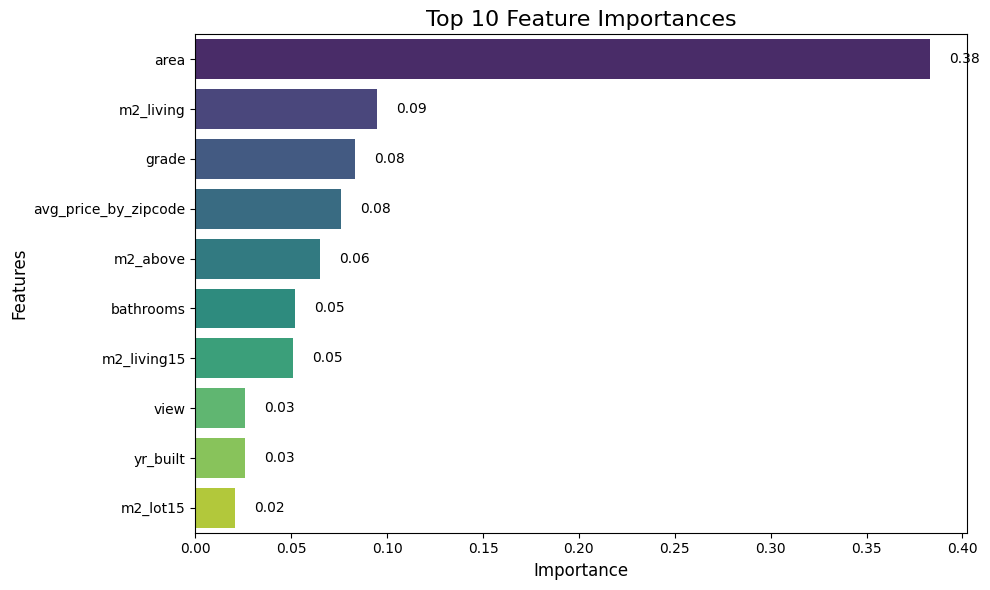

In [16]:
# Horizontal bar chart
plt.figure(figsize=(10, 6))
sns.barplot(
    x='importance', y='feature',
    data=top_features,
    palette='viridis'
)
plt.title('Top 10 Feature Importances', fontsize=16)
plt.xlabel('Importance', fontsize=12)
plt.ylabel('Features', fontsize=12)

# Add values to the end of the bars.
for i, v in enumerate(top_features['importance']):
    plt.text(v + 0.01, i, f"{v:.2f}", color='black', va='center')

plt.tight_layout()
plt.show()

**#Which features should I select?**

In [64]:
# Select features with importance greater than 0.05.
threshold = 0.05
selected_features = feature_importances[feature_importances['importance'] > threshold]['feature'].tolist()

# Create a new dataset with only the selected features.
X_selected = X[selected_features]

print(f"Selected features ({len(selected_features)}): {selected_features}")

Selected features (7): ['area', 'm2_living', 'grade', 'avg_price_by_zipcode', 'm2_above', 'bathrooms', 'm2_living15']


**Classification Model: "normal" houses < 1,000,000 vs luxury houses >= 1,000,000**


In [65]:
# Select the relevant features.
X = df_transformed.drop(columns=['id', 'date', 'price', 'price_category','lat','long'])
y_price_category = df_transformed['price_category']


In [66]:
# Split the dataset into training and testing.
X_train, X_test, y_train_price_category, y_test_price_category = train_test_split(
    X, y_price_category, test_size=0.2, random_state=42, stratify=y_price_category
)

In [67]:
# Define the columns for the transformations.
numerical_features = ["m2_living","grade","avg_price_by_zipcode","m2_above","bathrooms", "m2_living15"]
categorical_features = ["area"]

In [68]:
# Create a ColumnTransformer
preprocessor = ColumnTransformer(
    transformers=[
        ("cat", OneHotEncoder(handle_unknown="ignore",sparse_output=False), categorical_features),  # Procesar 'zipcode'
        ('num', StandardScaler(), numerical_features),  # Pasar numéricos sin cambios
    ]
)

In [69]:
# Create a pipeline
pipeline_xgboostClass = ImbPipeline([
    ("preprocessor", preprocessor),  # Preprocesamiento completo
    ('scaler', StandardScaler()),    # Escalado de datos
    ('classifier', XGBClassifier(random_state=42))  # Modelo base
])

In [70]:
# Train the XGBoost Classifier model.
XGBClassifier_best_model = XGBClassifier(random_state=42)
XGBClassifier_best_model.fit(X_train, y_train_price_category)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=None,
              num_parallel_tree=None, random_state=42, ...)

In [71]:
# Make predictions and evaluate the model.
y_pred_price_category = XGBClassifier_best_model.predict(X_test)

In [72]:
# Evaluate the model
f1 = f1_score(y_test_price_category, y_pred_price_category)
accuracy = accuracy_score(y_test_price_category, y_pred_price_category)
balanced_acc = balanced_accuracy_score(y_test_price_category, y_pred_price_category)  # Balanced Accuracy
conf_matrix = confusion_matrix(y_test_price_category, y_pred_price_category)
report = classification_report(y_test_price_category, y_pred_price_category)

# Calculate MSE and RMSE
mse = mean_squared_error(y_test_price_category, y_pred_price_category)
rmse = np.sqrt(mse)

# Results
print("Precisión general (Accuracy):", accuracy)
print("Precisión balanceada (Balanced Accuracy):", balanced_acc)
print("Matriz de confusión:\n", conf_matrix)
print("Informe de clasificación:\n", report)
print("Error Cuadrático Medio (MSE):", mse)
print("Raíz del Error Cuadrático Medio (RMSE):", rmse)

Precisión general (Accuracy): 0.9868147120055517
Precisión balanceada (Balanced Accuracy): 0.9369886197840677
Matriz de confusión:
 [[4004   21]
 [  36  262]]
Informe de clasificación:
               precision    recall  f1-score   support

           0       0.99      0.99      0.99      4025
           1       0.93      0.88      0.90       298

    accuracy                           0.99      4323
   macro avg       0.96      0.94      0.95      4323
weighted avg       0.99      0.99      0.99      4323

Error Cuadrático Medio (MSE): 0.0131852879944483
Raíz del Error Cuadrático Medio (RMSE): 0.11482720929487183


In [56]:
#Save price category classifier model.
with open('XGBClassifier_best_model.pkl', 'wb') as file:
    pickle.dump(XGBClassifier_best_model, file)

print("Modelo guardado exitosamente como 'XGBClassifier_best_model.pkl'")

Modelo guardado exitosamente como 'XGBClassifier_best_model.pkl'


**Split the Data by Class**

In [73]:
# Generate predictions for the entire database.
prediction_all = XGBClassifier_best_model.predict(X)

# Separate the two classes into two different DataFrames.
df_class_0 = df[df['price'] < 1_000_000].copy()
df_class_1 = df[df['price'] >= 1_000_000].copy()

In [74]:
#Validate the Split

print(f"Class 0: {len(df_class_0)} samples")
print(f"Class 1: {len(df_class_1)} samples")

Class 0: 20121 samples
Class 1: 1492 samples


**Let´s visualize results: Real Data vs Predicted Data for all the dataset**

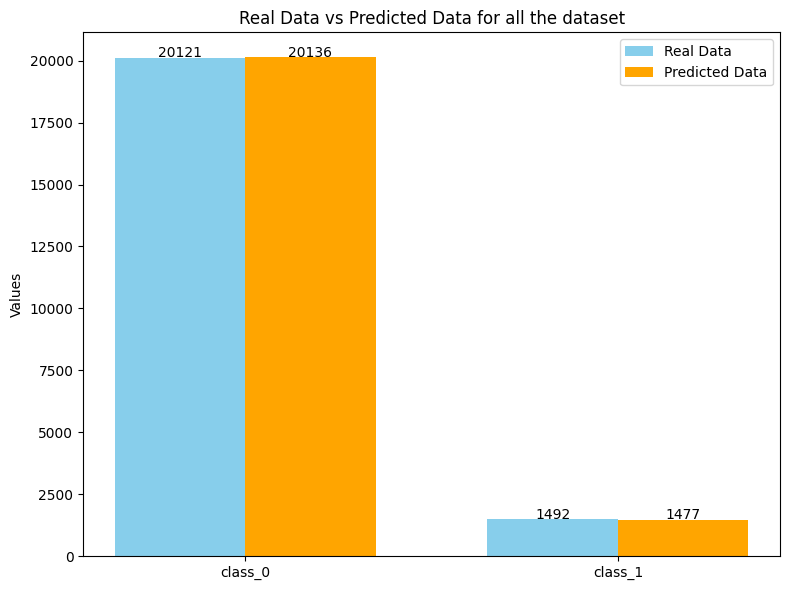

In [ ]:
categories= ['class_0', 'class_1']
real_data = [20121, 1492]
predicted_data = [20136, 1477]

# Configurar el ancho de las barras y la posición
ancho_barra = 0.35  # Ancho de las barras
x = np.arange(len(categories))  # Posición de las categorías

# Crear el gráfico de barras
plt.figure(figsize=(8, 6))
barras_reales = plt.bar(x - ancho_barra/2, real_data, width=ancho_barra, color='skyblue', label='Real Data')
barras_previstas = plt.bar(x + ancho_barra/2, predicted_data, width=ancho_barra, color='orange', label='Predicted Data')

# Agregar etiquetas y título
plt.xlabel('')
plt.ylabel('Values')
plt.title('Real Data vs Predicted Data for all the dataset' )
plt.xticks(x, categories)  # Agregar etiquetas a las posiciones de las barras
plt.legend()

# Añadir los valores encima de cada barra
for barra in barras_reales:
    plt.text(barra.get_x() + barra.get_width()/2, barra.get_height() + 10, str(barra.get_height()), ha='center', fontsize=10)

for barra in barras_previstas:
    plt.text(barra.get_x() + barra.get_width()/2, barra.get_height() + 10, str(barra.get_height()), ha='center', fontsize=10)

# Ajustar y mostrar el gráfico
plt.tight_layout()
plt.show()


**Regression Model for Class 0**

**Given the positively skewed distribution of the "m2_living" variable selected for regression model testing, we apply a logarithmic transformation to convert it into a "more normal" distribution, thereby improving its usefulness in the model.**

In [75]:
df_class_0['m2_living_Log'] = np.log1p(df_class_0['m2_living']) 

In [76]:
# We separate features and targets again.
X_class_0 = df_class_0.drop(columns=['date','id', 'price'])  # Eliminar columnas no relevantes para las características
y_class_0 = df_class_0['price']  # Variable continua para precio (opcional)

In [77]:
X_train_class_0, X_test_class_0, y_train_class_0, y_test_class_0 = train_test_split(
    X_class_0, y_class_0, test_size=0.2, random_state=42
)

In [78]:
print("Columnas disponibles en X_class_0:", X_class_0.columns.tolist())

Columnas disponibles en X_class_0: ['bedrooms', 'bathrooms', 'm2_living', 'm2_lot', 'floors', 'waterfront', 'view', 'condition', 'grade', 'm2_above', 'm2_basement', 'yr_built', 'yr_renovated', 'zipcode', 'lat', 'long', 'm2_living15', 'm2_lot15', 'basement', 'renovated', 'area', 'avg_price_by_zipcode', 'm2_living_Log']


In [79]:
# Define the columns for the transformations.
numerical_features = ["m2_living_Log","grade","avg_price_by_zipcode","m2_above","bathrooms", "m2_living15"]
categorical_features = ["area"]

In [80]:
# Crear un ColumnTransformer
preprocessor = ColumnTransformer(
    transformers=[
        ("cat", OneHotEncoder(handle_unknown="ignore",sparse_output=False), categorical_features),  # Procesar 'zipcode'
        ('num', StandardScaler(), numerical_features),  # Pasar numéricos sin cambios
    ]
)

In [72]:
# Create the pipeline with the preprocessor and a Ridge regression model.
pipeline1 = Pipeline(steps=[
    ('preprocessor', preprocessor),                 # Preprocessor for numerical and categorical variables   
    ('regressor', Ridge(random_state=42))        # Regressor Model
])

In [73]:
# Define the parameters for GridSearchCV.
param_grid = {
    'regressor__alpha': [0.0001, 0.001, 0.01],
    'regressor__solver': ['auto', 'sparse_cg', 'lsqr', 'sag'],
    'regressor__max_iter': [500, 1000, 5000]
}

In [74]:
# Set up GridSearchCV with cross-validation.
grid_search_ridge = GridSearchCV(
    pipeline1,
    param_grid=param_grid,
    cv=5,  # Validación cruzada de 5 folds
    scoring='neg_root_mean_squared_error',  
    verbose=1,
    n_jobs=-1  # Usar todos los núcleos disponibles
)

In [75]:
# Train GridSearchCV
grid_search_ridge.fit(X_train_class_0, y_train_class_0)

Fitting 5 folds for each of 36 candidates, totalling 180 fits


GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('preprocessor',
                                        ColumnTransformer(transformers=[('cat',
                                                                         OneHotEncoder(handle_unknown='ignore',
                                                                                       sparse_output=False),
                                                                         ['area']),
                                                                        ('num',
                                                                         StandardScaler(),
                                                                         ['m2_living_Log',
                                                                          'grade',
                                                                          'avg_price_by_zipcode',
                                                                          'm2_above',
                                                                          'bathrooms',
                                                                          'm2_living15'])])),
                                       ('regressor', Ridge(random_state=42))]),
             n_jobs=-1,
             param_grid={'regressor__alpha': [0.0001, 0.001, 0.01],
                         'regressor__max_iter': [500, 1000, 5000],
                         'regressor__solver': ['auto', 'sparse_cg', 'lsqr',
                                               'sag']},
             scoring='neg_root_mean_squared_error', verbose=1)

In [76]:
# Obtain the best parameters and performance.
best_params_ridge = grid_search_ridge.best_params_
best_score_ridge = grid_search_ridge.best_score_

print("Mejores parámetros:", best_params_ridge)
print("Mejor RMSE:", best_score_ridge)

Mejores parámetros: {'regressor__alpha': 0.01, 'regressor__max_iter': 500, 'regressor__solver': 'lsqr'}
Mejor RMSE: -82122.24691858346


In [77]:
# Create the pipeline with the preprocessor and a Lasso regression model.
pipeline2 = Pipeline(steps=[
    ('preprocessor', preprocessor),                    
    ('regressor', Lasso(random_state=42))       
])

In [78]:
# Define the parameters for GridSearchCV.
param_grid = {
    'regressor__alpha': [0.0001, 0.001, 0.01, 1],
    'regressor__max_iter': [200, 300, 350],
    'regressor__tol': [ 1e-11, 1e-10, 1e-09],
    'regressor__selection': ['cyclic', 'random']
}

In [79]:
# Set up GridSearchCV with cross-validation.
grid_search_lasso = GridSearchCV(
    pipeline2,
    param_grid=param_grid,
    cv=5,  # Validación cruzada de 5 folds
    scoring='neg_root_mean_squared_error',  
    verbose=1,
    n_jobs=-1  # Usar todos los núcleos disponibles
)

In [80]:
# Train GridSearchCV
grid_search_lasso.fit(X_train_class_0, y_train_class_0)

Fitting 5 folds for each of 72 candidates, totalling 360 fits


GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('preprocessor',
                                        ColumnTransformer(transformers=[('cat',
                                                                         OneHotEncoder(handle_unknown='ignore',
                                                                                       sparse_output=False),
                                                                         ['area']),
                                                                        ('num',
                                                                         StandardScaler(),
                                                                         ['m2_living_Log',
                                                                          'grade',
                                                                          'avg_price_by_zipcode',
                                                                          'm2_above',
                                                                          'bathrooms',
                                                                          'm2_living15'])])),
                                       ('regressor', Lasso(random_state=42))]),
             n_jobs=-1,
             param_grid={'regressor__alpha': [0.0001, 0.001, 0.01, 1],
                         'regressor__max_iter': [200, 300, 350],
                         'regressor__selection': ['cyclic', 'random'],
                         'regressor__tol': [1e-11, 1e-10, 1e-09]},
             scoring='neg_root_mean_squared_error', verbose=1)

In [81]:
# Obtain the best parameters and performance.
best_params_lasso = grid_search_lasso.best_params_
best_score_lasso = grid_search_lasso.best_score_

print("Mejores parámetros:", best_params_lasso)
print("Mejor RMSE:", best_score_lasso)

Mejores parámetros: {'regressor__alpha': 1, 'regressor__max_iter': 200, 'regressor__selection': 'random', 'regressor__tol': 1e-11}
Mejor RMSE: -82122.3218880013


In [82]:
# Create the pipeline with the preprocessor and a Random Forest regression model.
pipeline3 = Pipeline(steps=[
    ('preprocessor', preprocessor),  
                                  # Preprocesador para numéricas y categóricas      
    ('regressor', RandomForestRegressor(random_state=42))        # Modelo de clasificación
])

In [83]:
# Define the parameters for GridSearchCV.
param_grid = {
    'regressor__n_estimators': [50, 100, 200],
    'regressor__max_depth': [3, 4, 5, 6, 7,8, 10],
    'regressor__min_samples_split': [3, 5, 10, 12],
    'regressor__min_samples_leaf': [3, 4, 5],
    'regressor__max_features': ['auto', 'sqrt', 'log2']

}

In [84]:
# Set up GridSearchCV with cross-validation.
grid_search_rf = GridSearchCV(
    pipeline3,
    param_grid=param_grid,
    cv=5,  # Validación cruzada de 5 folds
    scoring='neg_root_mean_squared_error',  
    verbose=1,
    n_jobs=-1  # Usar todos los núcleos disponibles
)

In [85]:
# Train GridSearchCV
grid_search_rf.fit(X_train_class_0, y_train_class_0)

Fitting 5 folds for each of 756 candidates, totalling 3780 fits


GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('preprocessor',
                                        ColumnTransformer(transformers=[('cat',
                                                                         OneHotEncoder(handle_unknown='ignore',
                                                                                       sparse_output=False),
                                                                         ['area']),
                                                                        ('num',
                                                                         StandardScaler(),
                                                                         ['m2_living_Log',
                                                                          'grade',
                                                                          'avg_price_by_zipcode',
                                                                          'm2_above',
                                                                          'bathrooms',
                                                                          'm2_living15'])])),
                                       ('regressor',
                                        RandomForestRegressor(random_state=42))]),
             n_jobs=-1,
             param_grid={'regressor__max_depth': [3, 4, 5, 6, 7, 8, 10],
                         'regressor__max_features': ['auto', 'sqrt', 'log2'],
                         'regressor__min_samples_leaf': [3, 4, 5],
                         'regressor__min_samples_split': [3, 5, 10, 12],
                         'regressor__n_estimators': [50, 100, 200]},
             scoring='neg_root_mean_squared_error', verbose=1)

In [86]:
# Obtain the best parameters and performance.
best_params_rf = grid_search_rf.best_params_
best_score_rf = grid_search_rf.best_score_

print("Mejores parámetros:", best_params_rf)
print("Mejor RMSE:", best_score_rf)

Mejores parámetros: {'regressor__max_depth': 10, 'regressor__max_features': 'sqrt', 'regressor__min_samples_leaf': 3, 'regressor__min_samples_split': 3, 'regressor__n_estimators': 200}
Mejor RMSE: -75366.23007914804


In [87]:
# Create the pipeline with the preprocessor and an XGBoost regression model.
pipeline4 = Pipeline(steps=[
    ('preprocessor', preprocessor),                                       
    ('regressor', XGBRegressor(random_state=42))       
])

In [88]:
# Define the parameters for GridSearchCV.
param_grid = {
    'regressor__n_estimators': [50, 100, 200],
    'regressor__learning_rate': [0.01, 0.1, 0.2, 0.5],
    'regressor__max_depth': [3, 5, 7, 9],
    'regressor__subsample': [0.8, 1.0, 1.2],
    'regressor__colsample_bytree': [0.4, 0.6, 0.8, 1],
    'regressor__gamma': [0,1, 2]
}

In [89]:
# Set up GridSearchCV with cross-validation.
grid_search_xgboost = GridSearchCV(
    pipeline4,
    param_grid=param_grid,
    cv=3,  # Validación cruzada de 3 folds
    scoring='neg_root_mean_squared_error',  
    verbose=1,
    n_jobs=-1  # Usar todos los núcleos disponibles
)

In [90]:
# Train GridSearchCV
grid_search_xgboost.fit(X_train_class_0, y_train_class_0)

Fitting 3 folds for each of 1728 candidates, totalling 5184 fits


GridSearchCV(cv=3,
             estimator=Pipeline(steps=[('preprocessor',
                                        ColumnTransformer(transformers=[('cat',
                                                                         OneHotEncoder(handle_unknown='ignore',
                                                                                       sparse_output=False),
                                                                         ['area']),
                                                                        ('num',
                                                                         StandardScaler(),
                                                                         ['m2_living_Log',
                                                                          'grade',
                                                                          'avg_price_by_zipcode',
                                                                          'm2_above',
                                                                          'bathrooms',
                                                                          'm2_living15'])])),
                                       ('regressor',
                                        XGBRegressor(base_score=None,
                                                     booster=None,
                                                     callbacks=Non...
                                                     n_jobs=None,
                                                     num_parallel_tree=None,
                                                     random_state=42, ...))]),
             n_jobs=-1,
             param_grid={'regressor__colsample_bytree': [0.4, 0.6, 0.8, 1],
                         'regressor__gamma': [0, 1, 2],
                         'regressor__learning_rate': [0.01, 0.1, 0.2, 0.5],
                         'regressor__max_depth': [3, 5, 7, 9],
                         'regressor__n_estimators': [50, 100, 200],
                         'regressor__subsample': [0.8, 1.0, 1.2]},
             scoring='neg_root_mean_squared_error', verbose=1)

In [120]:
# Obtain the best parameters and performance.
best_params_xgboost = grid_search_xgboost.best_params_
best_score_xgboost = grid_search_xgboost.best_score_

print("Mejores parámetros:", best_params_xgboost)
print("Mejor RMSE:", best_score_xgboost)

Mejores parámetros: {'regressor__colsample_bytree': 0.6, 'regressor__gamma': 0, 'regressor__learning_rate': 0.1, 'regressor__max_depth': 5, 'regressor__n_estimators': 200, 'regressor__subsample': 1.0}
Mejor RMSE: -73931.58209656375


In [91]:
# Create the pipeline with the preprocessor and an SVR regression model.
pipeline5 = Pipeline(steps=[
    ('preprocessor', preprocessor),                                      
    ('regressor', SVR())        
])

In [92]:
# Define the parameters for GridSearchCV.
param_grid = {
    'regressor__C': [ 1, 10,100],
    'regressor__epsilon': [0.01, 0.1, 0.5],
    'regressor__kernel': ['linear', 'rbf','poly'],
    'regressor__gamma': [ 0.01, 0.1, 1],
    'regressor__degree': [2, 3]  # Solo aplica si kernel = 'poly'
}

In [93]:
# Set up GridSearchCV with cross-validation.
grid_search_svr = GridSearchCV(
    pipeline5,
    param_grid=param_grid,
    cv=5,  # Validación cruzada de 5 folds
    scoring='neg_root_mean_squared_error',  
    verbose=1,
    n_jobs=-1  # Usar todos los núcleos disponibles
)

In [94]:
# Train GridSearchCV
grid_search_svr.fit(X_train_class_0, y_train_class_0)

Fitting 5 folds for each of 162 candidates, totalling 810 fits


GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('preprocessor',
                                        ColumnTransformer(transformers=[('cat',
                                                                         OneHotEncoder(handle_unknown='ignore',
                                                                                       sparse_output=False),
                                                                         ['area']),
                                                                        ('num',
                                                                         StandardScaler(),
                                                                         ['m2_living_Log',
                                                                          'grade',
                                                                          'avg_price_by_zipcode',
                                                                          'm2_above',
                                                                          'bathrooms',
                                                                          'm2_living15'])])),
                                       ('regressor', SVR())]),
             n_jobs=-1,
             param_grid={'regressor__C': [1, 10, 100],
                         'regressor__degree': [2, 3],
                         'regressor__epsilon': [0.01, 0.1, 0.5],
                         'regressor__gamma': [0.01, 0.1, 1],
                         'regressor__kernel': ['linear', 'rbf', 'poly']},
             scoring='neg_root_mean_squared_error', verbose=1)

In [95]:
# Obtain the best parameters and performance.
best_params_svr = grid_search_svr.best_params_
best_score_svr = grid_search_svr.best_score_

print("Mejores parámetros:", best_params_svr)
print("Mejor RMSE:", best_score_svr)

Mejores parámetros: {'regressor__C': 100, 'regressor__degree': 3, 'regressor__epsilon': 0.5, 'regressor__gamma': 1, 'regressor__kernel': 'poly'}
Mejor RMSE: -85868.58922529609


To maximize overall accuracy, I use neg_root_mean_squared_error **(RMSE)** as the metric.

In [96]:
# Dictionary with unique names and corresponding GridSearchCV objects.
pipelines = {
    'pipeline1_ridge': grid_search_ridge,
    'pipeline2_lasso': grid_search_lasso,
    'pipeline3_rf': grid_search_rf,
    'pipeline4_xgboost': grid_search_xgboost,
    'pipeline5_svr': grid_search_svr

}

# Save each model with a unique name.
for name, grid_search in pipelines.items():
    best_model = grid_search.best_estimator_  # Obtener el mejor modelo
    file_name = f"{name}_best_model.pkl"  # Crear el nombre del archivo
    with open(file_name, 'wb') as file:
        pickle.dump(best_model, file)  # Guardar el modelo
    print(f"Modelo {name} guardado como {file_name}")

Modelo pipeline1_ridge guardado como pipeline1_ridge_best_model.pkl
Modelo pipeline2_lasso guardado como pipeline2_lasso_best_model.pkl
Modelo pipeline3_rf guardado como pipeline3_rf_best_model.pkl
Modelo pipeline4_xgboost guardado como pipeline4_xgboost_best_model.pkl
Modelo pipeline5_svr guardado como pipeline5_svr_best_model.pkl


**Validation and evaluation of the best model on the test set**

In [81]:
# List of saved model names
model_files = [
    'pipeline1_ridge_best_model.pkl',
    'pipeline2_lasso_best_model.pkl',
    'pipeline3_rf_best_model.pkl',
    'pipeline4_xgboost_best_model.pkl',
    'pipeline5_svr_best_model.pkl'
]

#Load models into a dictionary.
models = {}
for i, file_name in enumerate(model_files, start=1):
    with open(file_name, 'rb') as file:
        models[f'model_{i}'] = pickle.load(file)

print(f"{len(models)} modelos cargados con éxito.")

5 modelos cargados con éxito.


**We make the prediction with each of the models.**

In [82]:
# Dictionary to store the metrics of each model.
model_performance = {}

# Make predictions and evaluate each model.
for name, model in models.items():
    predictions = model.predict(X_test_class_0)  # Predicciones del modelo
    mse = mean_squared_error(y_test_class_0, predictions)  # Calcular MSE
    rmse = np.sqrt(mse)  # Calcular RMSE
    mae = mean_absolute_error(y_test_class_0, predictions)  # Calcular MAE
    r2 = r2_score(y_test_class_0, predictions)  # Calcular R²
    medae = median_absolute_error(y_test_class_0, predictions)  # Calcular MedAE

    # Save all metrics in a dictionary.
    model_performance[name] = {
        'MSE': mse,
        'RMSE': rmse,
        'MAE': mae,
        'R²': r2,
        'MedAE': medae
    }

# Show the performance of each model.
for model_name, metrics in model_performance.items():
    print(f"Resultados para {model_name}:")
    for metric_name, value in metrics.items():
        print(f"  {metric_name}: {value:.4f}")
    print()

Resultados para model_1:
  MSE: 6675878915.2216
  RMSE: 81706.0519
  MAE: 62051.9917
  R²: 0.8210
  MedAE: 49074.5142

Resultados para model_2:
  MSE: 6675674345.8389
  RMSE: 81704.8000
  MAE: 62050.9970
  R²: 0.8210
  MedAE: 49042.2657

Resultados para model_3:
  MSE: 5509371058.2276
  RMSE: 74225.1376
  MAE: 55143.4807
  R²: 0.8523
  MedAE: 42052.3018

Resultados para model_4:
  MSE: 5092336096.5754
  RMSE: 71360.6061
  MAE: 52190.4166
  R²: 0.8635
  MedAE: 39666.5625

Resultados para model_5:
  MSE: 6791147912.8943
  RMSE: 82408.4214
  MAE: 59176.3802
  R²: 0.8179
  MedAE: 44229.2697



**We stick with model 4:**

XGBoost Regressor

Lower RMSE: 71360.6061

Lower MAE: 52190.4166

R² closer to 0: 0.8635



**Generate predictions for the entire class_0.**

In [83]:
# Load the model from the file.
with open('pipeline4_xgboost_best_model.pkl', 'rb') as file:
    loaded_model = pickle.load(file)

print("Modelo cargado exitosamente.")

Modelo cargado exitosamente.


In [ ]:

# Make predictions with all of X_class_1.
all_class_0_predictions = loaded_model.predict(X_class_0)


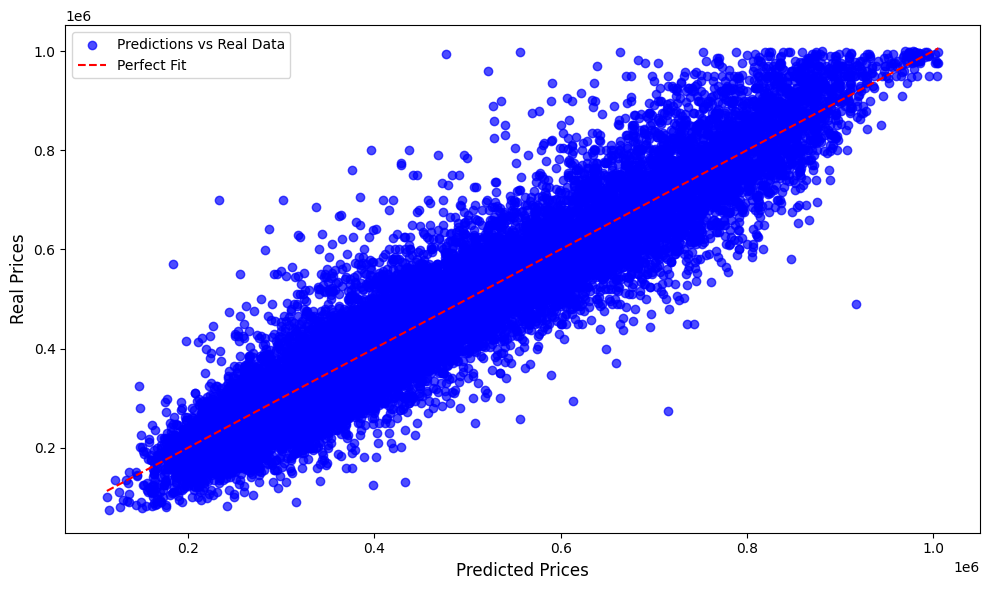

In [93]:
real_values = y_class_0  # Real Values
predictions = all_class_0_predictions    # Prediction for Class_0

# Scatter Plot Creation
plt.figure(figsize=(10, 6))
plt.scatter(predictions, real_values, alpha=0.7, color='blue', label='Predictions vs Real Data')
plt.plot([min(predictions), max(predictions)], [min(predictions), max(predictions)], 
         color='red', linestyle='--', label='Perfect Fit')  # Línea de referencia

# Labels and Title
plt.title('', fontsize=12)
plt.ylabel('Real Prices', fontsize=12)
plt.xlabel('Predicted Prices', fontsize=12)
plt.legend()

# Show scatter plot
plt.tight_layout()
plt.show()


**Classification Model for Class 1**

**Given the positively skewed distribution of the "m2_living" variable selected for regression model testing, we apply a logarithm to transform it into a "more normal" distribution, thereby improving its usefulness in the model.**

In [29]:
df_class_1['m2_living_Log'] = np.log1p(df_class_1['m2_living']) 

**We are going to create categories for houses over 1 million.
With the help of the histogram for that category of houses (class 1) and the sample count for each category, we will create 3 uniform groups.**

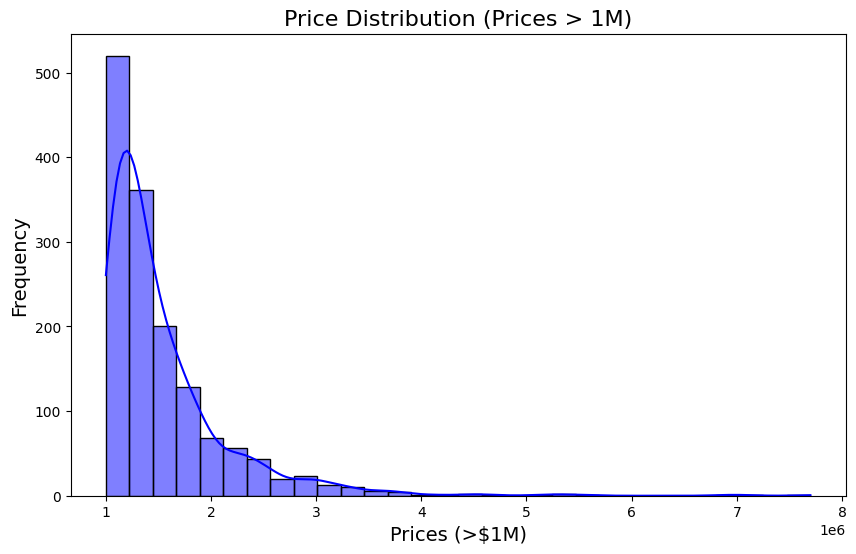

In [30]:
# Filter prices greater than 1 million.
filtered_prices = df[df['price'] > 1_000_000]['price']

# Create the histogram
plt.figure(figsize=(10, 6))
sns.histplot(filtered_prices, kde=True, bins=30, color='blue')  # Usar los datos filtrados
plt.title('Price Distribution (Prices > 1M)', fontsize=16)
plt.xlabel('Prices (>$1M)', fontsize=14)
plt.ylabel('Frequency', fontsize=14)

# Save the chart as a PNG file.
plt.savefig('Price_Distribution_Above_1M.png', dpi=300, bbox_inches='tight')

# Show plt
plt.show()


In [31]:
# Let's create our new categories:


# Define the price ranges and the labels for the categories.
bins = [1_000_000, 1_200_000, 1_500_000, float('inf')]  # Price range (>= 1M)
labels = ['1M-1.2M', '1.2M-1.5M', 'Above 1.5M']  # Labels for the categories.

# Create the new column with categories.
df['price_luxury_category'] = pd.cut(df['price'], bins=bins, labels=labels, right=False)

# Show the distribution of the new categories.
print(df['price_luxury_category'].value_counts())

price_luxury_category
Above 1.5M    533
1M-1.2M       485
1.2M-1.5M     474
Name: count, dtype: int64


**Manual mapping of labels to numbers in df_class_1.**


In [32]:
print(df_class_1.columns)

Index(['id', 'date', 'price', 'bedrooms', 'bathrooms', 'm2_living', 'm2_lot',
       'floors', 'waterfront', 'view', 'condition', 'grade', 'm2_above',
       'm2_basement', 'yr_built', 'yr_renovated', 'zipcode', 'lat', 'long',
       'm2_living15', 'm2_lot15', 'basement', 'renovated', 'area',
       'avg_price_by_zipcode', 'm2_living_Log'],
      dtype='object')


In [33]:
# Create the 'price_luxury_category' column using conditions.
df_class_1['price_luxury_category'] = pd.cut(
    df_class_1['price'], 
    bins=[1_000_000, 1_200_000, 1_500_000, float('inf')],  # Definimos los límites
    labels=[0, 1, 2],  # Asignamos las categorías correspondientes
    right=False  # Cerramos los intervalos por la izquierda
)

# Check results.
print(df_class_1[['price', 'price_luxury_category']].head())

        price price_luxury_category
5   1225000.0                     1
21  2000000.0                     2
49  1350000.0                     1
69  1325000.0                     1
70  1040000.0                     0


In [34]:
df_class_1.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1492 entries, 5 to 21606
Data columns (total 27 columns):
 #   Column                 Non-Null Count  Dtype         
---  ------                 --------------  -----         
 0   id                     1492 non-null   int64         
 1   date                   1492 non-null   datetime64[ns]
 2   price                  1492 non-null   float64       
 3   bedrooms               1492 non-null   int64         
 4   bathrooms              1492 non-null   float64       
 5   m2_living              1492 non-null   float64       
 6   m2_lot                 1492 non-null   float64       
 7   floors                 1492 non-null   float64       
 8   waterfront             1492 non-null   int64         
 9   view                   1492 non-null   int64         
 10  condition              1492 non-null   int64         
 11  grade                  1492 non-null   int64         
 12  m2_above               1492 non-null   float64       
 13  m2_base

In [35]:
# We separate features and targets again.
X_class_1 = df_class_1.drop(columns=['date','id', 'price','price_luxury_category' ])  
y_class_1 = df_class_1['price_luxury_category']  

In [36]:
X_train_class_1, X_test_class_1, y_train_class_1, y_test_class_1 = train_test_split(
    X_class_1, y_class_1, test_size=0.2, random_state=42
)

In [37]:
print("Columnas disponibles en X_class_1:", X_class_1.columns.tolist())

Columnas disponibles en X_class_1: ['bedrooms', 'bathrooms', 'm2_living', 'm2_lot', 'floors', 'waterfront', 'view', 'condition', 'grade', 'm2_above', 'm2_basement', 'yr_built', 'yr_renovated', 'zipcode', 'lat', 'long', 'm2_living15', 'm2_lot15', 'basement', 'renovated', 'area', 'avg_price_by_zipcode', 'm2_living_Log']


In [38]:
# Define the columns for the transformations.
numerical_features = ["m2_living_Log","grade","avg_price_by_zipcode","m2_above","bathrooms", "m2_living15"]
categorical_features = ["area"]

In [39]:
# Create a ColumnTransformer.
preprocessor = ColumnTransformer(
    transformers=[
        ("cat", OneHotEncoder(handle_unknown="ignore",sparse_output=False), categorical_features),  # Process 'zipcode'
        ('num', StandardScaler(), numerical_features),  
    ]
)

In [42]:
# Create the pipeline with the preprocessor and a random Forest Classifier model.
pipeline6 = Pipeline(steps=[
    ('preprocessor', preprocessor),                  
    ('classifier', RandomForestClassifier(random_state=42))        
])

In [43]:
# Define the parameters for GridSearchCV.
param_grid = {
    'classifier__n_estimators': [50, 100, 200],   
    'classifier__max_depth': [3, 4, 5, 6, 8, 10],  
    'classifier__min_samples_split': [3, 4, 5, 10],  
    'classifier__min_samples_leaf': [2, 3, 4, 5]    
}

In [44]:
# Set up GridSearchCV with cross-validation.
grid_search_rf_class_1 = GridSearchCV(
    pipeline6,
    param_grid=param_grid,
    cv=5,  # Validación cruzada de 5 folds
    scoring='accuracy', 
    verbose=1,
    n_jobs=-1  # Usar todos los núcleos disponibles
)

In [45]:
# Train GridSearchCV
grid_search_rf_class_1.fit(X_train_class_1, y_train_class_1)

Fitting 5 folds for each of 288 candidates, totalling 1440 fits


GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('preprocessor',
                                        ColumnTransformer(transformers=[('cat',
                                                                         OneHotEncoder(handle_unknown='ignore',
                                                                                       sparse_output=False),
                                                                         ['area']),
                                                                        ('num',
                                                                         StandardScaler(),
                                                                         ['m2_living_Log',
                                                                          'grade',
                                                                          'avg_price_by_zipcode',
                                                                          'm2_above',
                                                                          'bathrooms',
                                                                          'm2_living15'])])),
                                       ('classifier',
                                        RandomForestClassifier(random_state=42))]),
             n_jobs=-1,
             param_grid={'classifier__max_depth': [3, 4, 5, 6, 8, 10],
                         'classifier__min_samples_leaf': [2, 3, 4, 5],
                         'classifier__min_samples_split': [3, 4, 5, 10],
                         'classifier__n_estimators': [50, 100, 200]},
             scoring='accuracy', verbose=1)

In [46]:
# Obtain the best parameters and performance.
best_params_rf_class_1 = grid_search_rf_class_1.best_params_
best_score_rf_class_1 = grid_search_rf_class_1.best_score_

print("Mejores parámetros:", best_params_rf_class_1)
print("Mejor accuracy:", best_score_rf_class_1)

Mejores parámetros: {'classifier__max_depth': 10, 'classifier__min_samples_leaf': 2, 'classifier__min_samples_split': 3, 'classifier__n_estimators': 200}
Mejor accuracy: 0.6647304947083436


In [52]:
# Create the pipeline with the preprocessor and an XGBoost classification model.
pipeline7 = Pipeline(steps=[
    ('preprocessor', preprocessor),                 # Preprocesador para numéricas y categóricas      
    ('classifier', XGBClassifier(random_state=42))        # Modelo de clasificación
])

In [53]:
# Define the parameters for GridSearchCV.
param_grid = {
    'classifier__max_depth': [3, 4, 5, 7, 8],
    'classifier__gamma': [0, 1, 3, 5],
    'classifier__learning_rate': [0.1, 0.2, 0.3],
    'classifier__n_estimators': [50, 100, 200],
    'classifier__subsample': [0.6, 0.8, 1.0],
    'classifier__colsample_bytree': [0.8, 1.0, 1.2]
}

In [54]:
# Set up GridSearchCV with cross-validation.
grid_search_xgb_class_1 = GridSearchCV(
    pipeline7,
    param_grid=param_grid,
    cv=5,  # Validación cruzada de 5 folds
    scoring='accuracy', 
    verbose=1,
    n_jobs=-1  # Usar todos los núcleos disponibles
)

In [55]:
# Train GridSearchCV
grid_search_xgb_class_1.fit(X_train_class_1, y_train_class_1)

Fitting 5 folds for each of 1620 candidates, totalling 8100 fits


GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('preprocessor',
                                        ColumnTransformer(transformers=[('cat',
                                                                         OneHotEncoder(handle_unknown='ignore',
                                                                                       sparse_output=False),
                                                                         ['area']),
                                                                        ('num',
                                                                         StandardScaler(),
                                                                         ['m2_living_Log',
                                                                          'grade',
                                                                          'avg_price_by_zipcode',
                                                                          'm2_above',
                                                                          'bathrooms',
                                                                          'm2_living15'])])),
                                       ('classifier',
                                        XGBClassifier(base_score=None,
                                                      booster=None,
                                                      callbacks=N...
                                                      n_estimators=None,
                                                      n_jobs=None,
                                                      num_parallel_tree=None,
                                                      random_state=42, ...))]),
             n_jobs=-1,
             param_grid={'classifier__colsample_bytree': [0.8, 1.0, 1.2],
                         'classifier__gamma': [0, 1, 3, 5],
                         'classifier__learning_rate': [0.1, 0.2, 0.3],
                         'classifier__max_depth': [3, 4, 5, 7, 8],
                         'classifier__n_estimators': [50, 100, 200],
                         'classifier__subsample': [0.6, 0.8, 1.0]},
             scoring='accuracy', verbose=1)

In [56]:
# Obtain the best parameters and performance.
best_params_xgb_class_1 = grid_search_xgb_class_1.best_params_
best_score_xgb_class_1 = grid_search_xgb_class_1.best_score_

print("Mejores parámetros:", best_params_xgb_class_1)
print("Mejor accuracy:", best_score_xgb_class_1)

Mejores parámetros: {'classifier__colsample_bytree': 1.0, 'classifier__gamma': 0, 'classifier__learning_rate': 0.1, 'classifier__max_depth': 4, 'classifier__n_estimators': 50, 'classifier__subsample': 0.6}
Mejor accuracy: 0.6630884989979255


To maximize overall accuracy, I use **accuracy** as the metric.

In [58]:
# Dictionary with unique names and corresponding GridSearchCV objects.
pipelines = {
    'pipeline6_rf_class_1': grid_search_rf_class_1,
    'pipeline7_xgb_class_1': grid_search_xgb_class_1,
}

# Save each model with a unique name.
for name, grid_search in pipelines.items():
    best_model = grid_search.best_estimator_  
    file_name = f"{name}_best_model.pkl" 
    with open(file_name, 'wb') as file:
        pickle.dump(best_model, file) 
    print(f"Modelo {name} guardado como {file_name}")

Modelo pipeline6_rf_class_1 guardado como pipeline6_rf_class_1_best_model.pkl
Modelo pipeline7_xgb_class_1 guardado como pipeline7_xgb_class_1_best_model.pkl


**Validation and evaluation of the best model is test.**

In [40]:
# List of names of the saved models
model_files = [
    'pipeline6_rf_class_1_best_model.pkl',
    'pipeline7_xgb_class_1_best_model.pkl',

]

# Load the models into a dictionary.
models = {}
for i, file_name in enumerate(model_files, start=1):
    with open(file_name, 'rb') as file:
        models[f'model_{i}'] = pickle.load(file)

print(f"{len(models)} modelos cargados con éxito.")

2 modelos cargados con éxito.


**We make the prediction with each of the models.**

In [41]:

# Dictionary to store the metrics of each model
model_performance = {}

# Make predictions and evaluate each model.
for name, model in models.items():
    predictions_class_1 = model.predict(X_test_class_1)  # Predicciones
    accuracy = accuracy_score(y_test_class_1, predictions_class_1)
    balanced_acc = balanced_accuracy_score(y_test_class_1, predictions_class_1)
    f1_macro = f1_score(y_test_class_1, predictions_class_1, average='macro')  # F1 macro
    conf_matrix = confusion_matrix(y_test_class_1, predictions_class_1)
    report = classification_report(y_test_class_1, predictions_class_1, output_dict=False)

    # Save all the metrics in a dictionary.
    model_performance[name] = {
        'f1_macro': f1_macro,
        'accuracy': accuracy,
        'balanced_accuracy': balanced_acc,
        'conf_matrix': conf_matrix,
        'report': report
    }

# Show the performance of each model.
for model_name, metrics in model_performance.items():
    print(f"Resultados para {model_name}:")
    for metric_name, value in metrics.items():
        if isinstance(value, (int, float)):  # Si es un número, formatearlo
            print(f"  {metric_name}: {value:.4f}")
        elif isinstance(value, (list, np.ndarray)):  # Para matrices de confusión
            print(f"  {metric_name}:\n{value}")
        elif isinstance(value, str):  # Para el reporte de clasificación
            print(f"  {metric_name}:\n{value}")
    print()


Resultados para model_1:
  f1_macro: 0.6533
  accuracy: 0.6522
  balanced_accuracy: 0.6521
  conf_matrix:
[[48 36  5]
 [ 8 65 13]
 [ 1 41 82]]
  report:
              precision    recall  f1-score   support

           0       0.84      0.54      0.66        89
           1       0.46      0.76      0.57        86
           2       0.82      0.66      0.73       124

    accuracy                           0.65       299
   macro avg       0.71      0.65      0.65       299
weighted avg       0.72      0.65      0.66       299


Resultados para model_2:
  f1_macro: 0.6547
  accuracy: 0.6555
  balanced_accuracy: 0.6558
  conf_matrix:
[[50 35  4]
 [ 9 64 13]
 [ 6 36 82]]
  report:
              precision    recall  f1-score   support

           0       0.77      0.56      0.65        89
           1       0.47      0.74      0.58        86
           2       0.83      0.66      0.74       124

    accuracy                           0.66       299
   macro avg       0.69      0.66      0

**BEST MODEL : MODEL 7:**

XGBoost Classifier

Better accuracy but very little difference.

**Generate predictions for the entire class_1.**

In [42]:
# Load the model from the file.
with open('pipeline7_xgb_class_1_best_model.pkl', 'rb') as file:
    loaded_model = pickle.load(file)

print("Modelo cargado exitosamente.")


Modelo cargado exitosamente.


In [44]:
import numpy as np
from collections import Counter

# Make predictions with all of X_class_1.
all_class_1_predictions = loaded_model.predict(X_class_1)

#Count how many samples there are in each category.
category_counts = Counter(all_class_1_predictions)

# Show Results
total_samples = sum(category_counts.values())
print(f"Número total de muestras predichas: {total_samples}")
print("Número de muestras predichas por categoría:")
for category, count in sorted(category_counts.items()):
    print(f"Categoría {category}: {count}")




Número total de muestras predichas: 1492
Número de muestras predichas por categoría:
Categoría 0: 378
Categoría 1: 677
Categoría 2: 437


In [114]:
print(f"Tipo de datos de las predicciones: {all_class_1_predictions.dtype}")
print(f"Valores únicos predichos: {np.unique(all_class_1_predictions)}")

Tipo de datos de las predicciones: int64
Valores únicos predichos: [0 1 2]


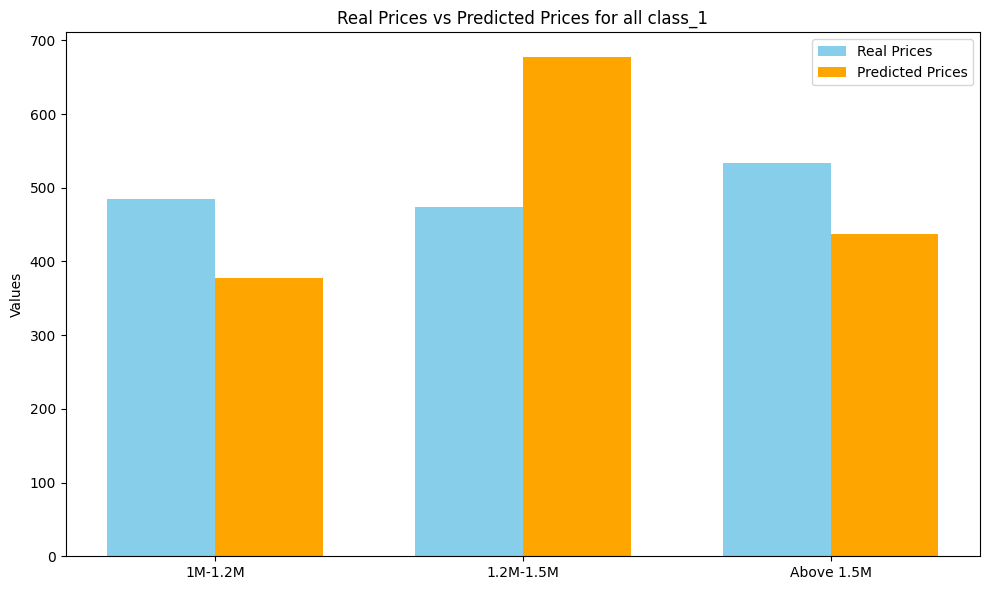

In [4]:
categories = ['1M-1.2M', '1.2M-1.5M', 'Above 1.5M']
real_data = [485, 474, 533]
predicted_data = [378, 677, 437]

# Configurar el ancho de las barras y la posición
ancho_barra = 0.35  # Ancho de las barras
x = np.arange(len(categories))  # Posición de las categorías

# Crear el gráfico de barras
plt.figure(figsize=(10, 6))
plt.bar(x - ancho_barra/2, real_data, width=ancho_barra, color='skyblue',label='Real Prices')
plt.bar(x + ancho_barra/2, predicted_data, width=ancho_barra, color='orange',label='Predicted Prices')

# Etiquetas y título
plt.xlabel('')
plt.ylabel('Values')
plt.title('Real Prices vs Predicted Prices for all class_1')
plt.xticks(x, categories)  # Agregar etiquetas a las posiciones de las barras
plt.legend()

# Mostrar el gráfico
plt.tight_layout()
plt.show()